In [7]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from glob import glob
from tqdm import tqdm
from natsort import natsorted
from latex import latexify

latexify(columns = 2)
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [8]:
def show_image_grid(images, M, N, title='Title', figsize=8):
    # Assuming 'images' is a numpy array of shape (num_images, height, width, channels)
    if M==1:
        row_size = figsize
        col_size = figsize//4
    elif N==1:
        row_size = figsize//4
        col_size = figsize
    else:
        row_size, col_size = figsize, figsize

    fig, axes = plt.subplots(M, N, figsize=(row_size, col_size))

    if len(images.shape) < 4:
        images = np.expand_dims(images.copy(), axis=0)

    fig.suptitle(title)
    for i in range(M):
        for j in range(N):
            if M==1 and N==1:
                ax = axes
            elif M == 1 or N==1:
                ax = axes[max(i, j)]
            else:
                ax = axes[i, j]
            index = i * N + j
            if index < images.shape[0]:
                ax.imshow(cv2.cvtColor(images[index], cv2.COLOR_BGR2RGB))
            ax.axis('off')
    plt.tight_layout()
    plt.show()

In [9]:
images_i1 = []
for im in tqdm(natsorted(glob('./images/i1/*.JPG'))):
    images_i1.append(cv2.imread(im))

images_i1 = np.array(images_i1)

100%|██████████| 6/6 [00:00<00:00, 18.11it/s]


In [10]:
images_i1[0].shape

(2448, 3264, 3)

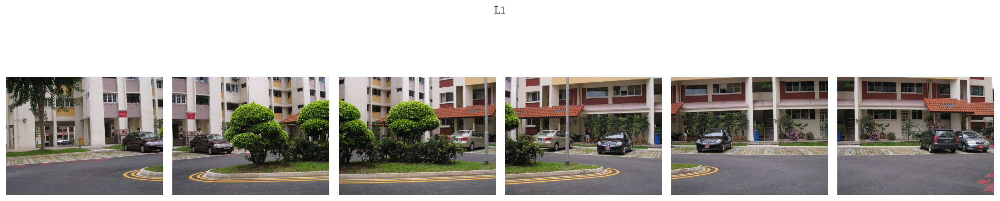

In [11]:
show_image_grid(images_i1, 1, 6, title='L1', figsize = 16)

20126 128


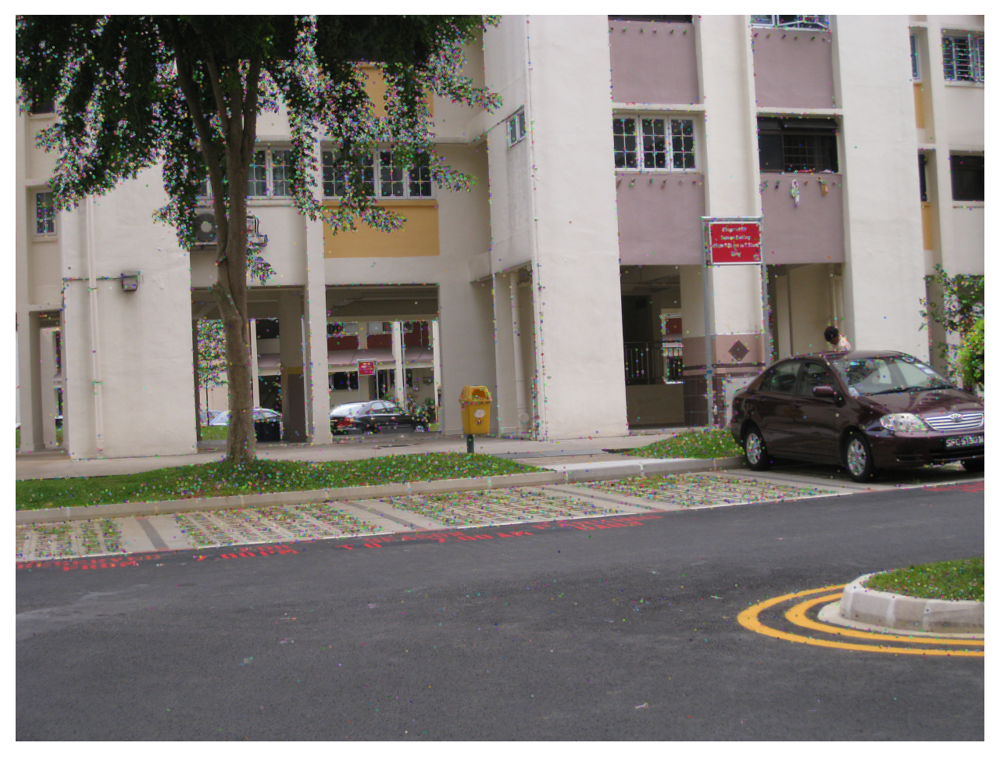

In [108]:
sift = cv2.SIFT_create()
image1 = images_i1[0]
keypoints1, descriptors1 = sift.detectAndCompute(image1, None)
image1_keypoints = cv2.drawKeypoints(image1, keypoints1, None)
print(len(keypoints1), len(descriptors1[0]))

plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(image1_keypoints, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [109]:
(keypoints1[0].pt, keypoints1[0].angle, keypoints1[0].size, keypoints1[0].response, keypoints1[0].octave, keypoints1[0].class_id)

((2.6013166904449463, 216.08755493164062),
 109.52603149414062,
 3.573972463607788,
 0.0342678502202034,
 16319487,
 -1)

In [9]:
descriptors1[0]

array([ 79.,  59.,  21.,   3.,   0.,   0.,   0.,   1.,  39.,  23.,  61.,
        56.,   0.,   0.,   1.,  82.,  42.,   1.,  16.,  21.,   0.,   0.,
        18., 159.,   5.,   1.,  22.,  11.,   0.,   0.,  30., 159.,  46.,
        71.,  10.,   0.,   0.,   0.,   0.,   2., 159.,  34.,  10.,   2.,
         0.,   0.,   0., 159., 126.,  10.,  52.,  62.,   4.,   0.,   1.,
       159.,   4.,   4., 140., 118.,   1.,   0.,   1.,  19.,  46.,  34.,
         6.,   0.,   0.,   0.,   0.,   0., 159.,  73.,   1.,   1.,   0.,
         0.,   0.,  19.,  53.,  16.,  14.,  40.,   9.,   0.,   0.,  10.,
         0.,   0.,  14.,  24.,   1.,   0.,   0.,   0.,   2.,   2.,   0.,
         0.,   0.,   0.,   0.,   0.,   4.,   2.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.], dtype=float32)

# Detect and Match Features using SIFT and FLANN

In [12]:
def detect_and_match_features(img1, img2):
    sift = cv2.SIFT_create()
    
    keypoints1, descriptors1 = sift.detectAndCompute(img1, None)
    keypoints2, descriptors2 = sift.detectAndCompute(img2, None)

    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    matches = flann.knnMatch(descriptors1, descriptors2, k=2)
    
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)

    points1 = np.zeros((len(good_matches), 2), dtype=np.float32)
    points2 = np.zeros((len(good_matches), 2), dtype=np.float32)
    
    for i, match in enumerate(good_matches):
        points1[i, :] = keypoints1[match.queryIdx].pt
        points2[i, :] = keypoints2[match.trainIdx].pt

    return points1, points2, keypoints1, keypoints2, good_matches

In [52]:
def draw_matches(img1, img2, keypoints1, keypoints2, matches):
    match_img = cv2.drawMatches(img1, keypoints1, img2, keypoints2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(15, 10))
    plt.imshow(cv2.cvtColor(match_img, cv2.COLOR_BGR2RGB))
    plt.title('Feature Matches')
    plt.axis('off')
    plt.show()

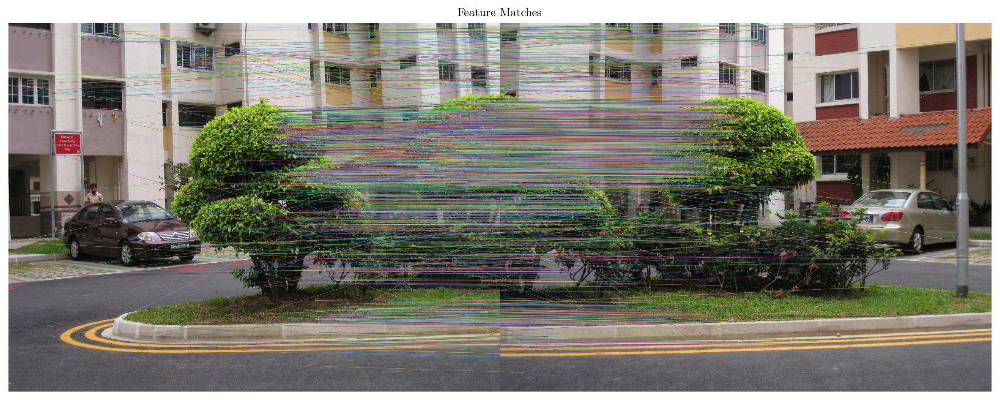

In [12]:
points1, points2, keypoints1, keypoints2, matches = detect_and_match_features(images_i1[1], images_i1[2])
draw_matches(images_i1[1], images_i1[2], keypoints1, keypoints2, matches)

In [13]:
print(points1.shape, points2.shape)
points1[:5], points2[:5]

(994, 2) (994, 2)


(array([[  3.071052,  59.421135],
        [ 32.478413, 231.76558 ],
        [ 42.343777, 161.34659 ],
        [ 84.82838 , 438.7817  ],
        [ 96.40571 , 685.4907  ]], dtype=float32),
 array([[   3.898206, 2061.483   ],
        [2356.988   , 1561.5869  ],
        [1750.6472  ,  853.6756  ],
        [1576.9343  , 1723.6377  ],
        [ 220.97719 ,  421.41663 ]], dtype=float32))

In [14]:
homography, mask = cv2.findHomography(points1, points2, cv2.RANSAC, 5.0)
print(homography.shape, mask.shape)
print(homography)

(3, 3) (994, 1)
[[ 1.09498774e+00 -3.05984305e-02 -2.20513818e+03]
 [ 5.29016294e-02  1.09043227e+00 -1.02133149e+02]
 [ 3.19606916e-05  1.69270837e-07  1.00000000e+00]]


[[[   0.    0.]]

 [[   0. 2447.]]

 [[3263. 2447.]]

 [[3263.    0.]]]
[[[-2205.1382    -102.13315 ]]

 [[-2279.0686    2565.092   ]]

 [[ 1170.3904    2479.196   ]]

 [[ 1238.6326      63.828354]]]
3517 2667
[[ 1.16782835e+00 -3.02126507e-02  7.39304214e+01]
 [ 5.61658755e-02  1.09044955e+00 -5.84889406e-07]
 [ 3.19606916e-05  1.69270837e-07  1.00000000e+00]]


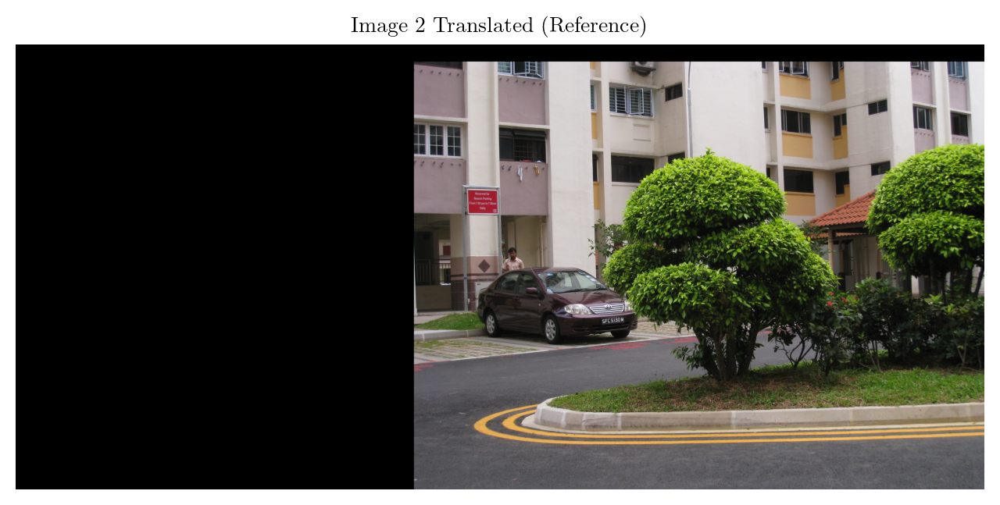

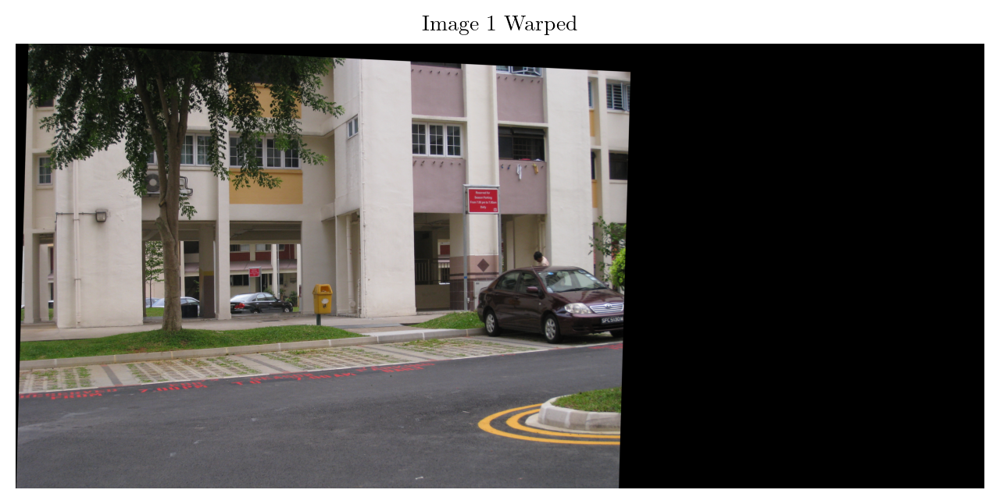

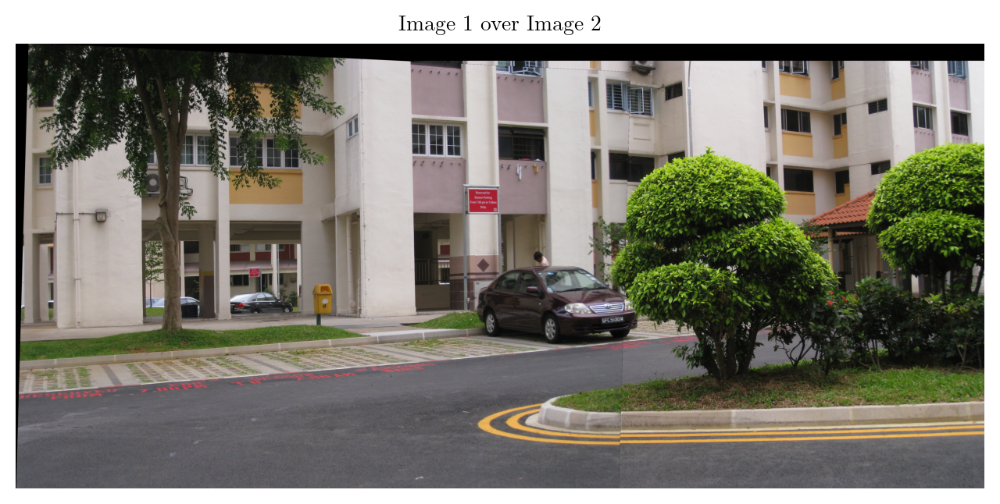

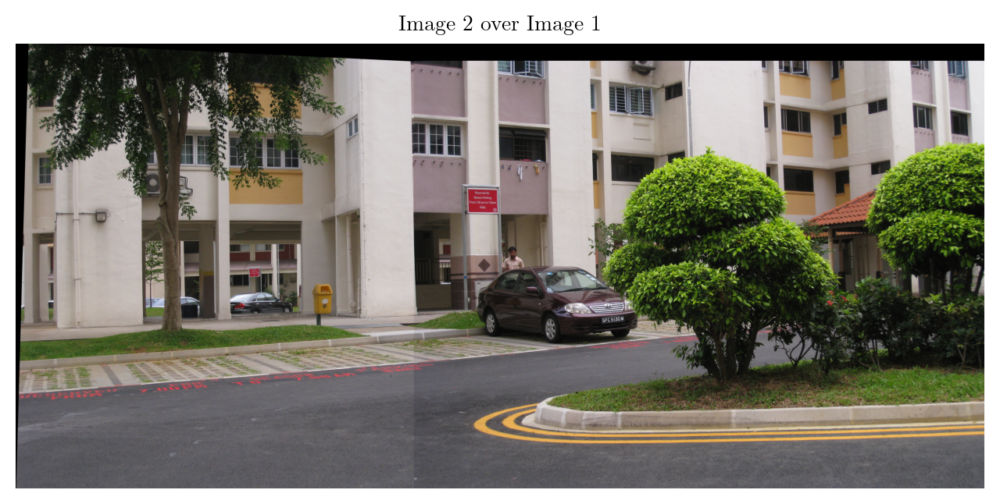

In [15]:
image1, image2 = images_i1[0], images_i1[1]

# find the corners of the destination image using the corners of the source image
h, w = image1.shape[:2]
corners = np.array([[0, 0], [0, h-1], [w-1, h-1], [w-1, 0]], dtype=np.float32)
corners = np.expand_dims(corners, axis=1)
dest_corners = cv2.perspectiveTransform(corners, homography)
print(corners)
print(dest_corners)

# now decide the size of the final canvas over which image1 will be warped
min_x, min_y = np.min(dest_corners, axis=0).ravel()
max_x, max_y = np.max(dest_corners, axis=0).ravel()
canvas_width = int(max_x - min_x)
canvas_height = int(max_y - min_y)
print(canvas_width, canvas_height)

# now we need to shift the homography matrix to shift the image to the top left corner
shift_matrix = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
final_homography = np.dot(shift_matrix, homography)
print(final_homography)


# now make the final canvas i.e. width = width of image2 - min_x, height = height of image2 - min_y
final_canvas_width = image2.shape[1] - int(min_x)
final_canvas_height = image2.shape[0] - int(min_y)

# translate image2 using the shift_matrix
image2_warped = cv2.warpPerspective(image2, shift_matrix, (final_canvas_width, final_canvas_height))
image1_warped = cv2.warpPerspective(image1, final_homography, (final_canvas_width, final_canvas_height))


plt.figure(figsize=(8, 8))
plt.title("Image 2 Translated (Reference)")
plt.imshow(cv2.cvtColor(image2_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 1 Warped")
plt.imshow(cv2.cvtColor(image1_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

non_zero_idx = np.where(image1_warped != 0)
final_final_canvas = image2_warped.copy()
final_final_canvas[non_zero_idx] = image1_warped[non_zero_idx]

non_zero_idx1 = np.where(image2_warped != 0)
final_final_canvas1 = image1_warped.copy()
final_final_canvas1[non_zero_idx1] = image2_warped[non_zero_idx1]

plt.figure(figsize=(8, 8))
plt.title("Image 1 over Image 2")
plt.imshow(cv2.cvtColor(final_final_canvas, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 2 over Image 1")
plt.imshow(cv2.cvtColor(final_final_canvas1, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Homography Estimation using RANSAC

In [13]:
def compute_homography(pts1, pts2):
    A = []
    for i in range(len(pts1)):
        x, y = pts1[i][0], pts1[i][1]
        x_prime, y_prime = pts2[i][0], pts2[i][1]
        A.append([-x, -y, -1, 0, 0, 0, x * x_prime, y * x_prime, x_prime])
        A.append([0, 0, 0, -x, -y, -1, x * y_prime, y * y_prime, y_prime])
    A = np.array(A)
    _, _, Vt = np.linalg.svd(A)
    H = Vt[-1].reshape(3, 3)
    return H / H[2, 2]

def compute_homography_ransac(points1, points2, iterations=1000, threshold=5.0):
    max_inliers = []
    points1_h = np.hstack([points1, np.ones((points1.shape[0], 1))])
    points2_h = np.hstack([points2, np.ones((points2.shape[0], 1))])

    for _ in range(iterations):
        idxs = np.random.choice(len(points1), 4, replace=False)
        pts1_sample = points1[idxs]
        pts2_sample = points2[idxs]

        H = compute_homography(pts1_sample, pts2_sample)

        projected_points = (H @ points1_h.T).T
        projected_points /= projected_points[:, 2:3]

        distances = np.linalg.norm(points2_h[:, :2] - projected_points[:, :2], axis=1)
        inliers = np.where(distances < threshold)[0]

        if len(inliers) > len(max_inliers):
            max_inliers = inliers
            
    inlier_pts1 = points1[max_inliers]
    inlier_pts2 = points2[max_inliers]
    best_H = compute_homography(inlier_pts1, inlier_pts2)

    return best_H, len(max_inliers)


In [24]:
H, len_max_inliers = compute_homography_ransac(points1, points2)
print(H.shape)
print(H)
print(len_max_inliers)

(3, 3)
[[ 1.14913539e+00 -3.64227311e-02 -2.31168535e+03]
 [ 7.63230761e-02  1.13047233e+00 -1.56002152e+02]
 [ 4.86925964e-05  4.21384715e-07  1.00000000e+00]]
438


# Get the Corners after transformation and Homography Estimation Function

In [14]:
def transform_corners(image, H):
    h, w = image.shape[:2]

    corners = np.array([[0, 0], [0, h-1], [w-1, h-1], [w-1, 0]], dtype=np.float32)
    corners = np.expand_dims(corners, axis=1)
    
    dest_corners = cv2.perspectiveTransform(corners, H)
    dest_corners = dest_corners.reshape(4, 2)

    min_x, min_y = np.min(dest_corners, axis=0)
    max_x, max_y = np.max(dest_corners, axis=0)

    return dest_corners, min_x, min_y, max_x, max_y


def estimate_homography(image1, image2, useOpenCV = False):
    points1, points2, _, _, _ = detect_and_match_features(image1, image2)
    if useOpenCV:
        H, _ = cv2.findHomography(points1, points2, cv2.RANSAC, 5.0)
    else:
        H, _ = compute_homography_ransac(points1, points2)
    return H

In [15]:
def visualize_homography_corners(images, homographies_wrt_reference, w, h):
    plt.figure(figsize=(15, 5))
    colors = plt.cm.viridis(np.linspace(0, 1, len(images)))

    for i, H in enumerate(homographies_wrt_reference):
        if H is not None:
            corners, _, _, _, _ = transform_corners(images[i], H)            
            plt.scatter(corners[:, 0], corners[:, 1], color=colors[i], label=f'Image {i}')
            plt.gca().add_patch(plt.Polygon(corners, edgecolor=colors[i], facecolor='none', linestyle='-', linewidth=2))

    plt.title('Transformed Corners of Images with Homographies')
    plt.xlabel('X-axis')
    plt.ylabel('Y-axis')
    plt.xlim(-100, w + 1000)
    plt.ylim(-100, h + 500)
    plt.grid()
    plt.legend()
    plt.show()

In [16]:
H1 = estimate_homography(images_i1[1], images_i1[2], useOpenCV=True)
H2 = estimate_homography(images_i1[1], images_i1[2], useOpenCV=False)
print(H1)
print()
print(H2)

[[ 1.19164549e+00 -1.04812978e-01 -1.97228895e+03]
 [ 8.23281259e-02  1.10258301e+00 -2.29710087e+02]
 [ 3.98183913e-05 -1.55437419e-05  1.00000000e+00]]

[[ 1.15521832e+00 -1.12062005e-01 -1.90338245e+03]
 [ 7.66092463e-02  1.04870608e+00 -1.99410649e+02]
 [ 3.44975123e-05 -4.08906391e-05  1.00000000e+00]]


# Stupid Time Waste :(

In [39]:
def panorama_stitcher(images, useOpenCV = False, first_over_last = True):
    """
    Args:
        images (List): List of Images to be stitched together
    """
    
    assert len(images) >= 2, "Number of images should be greater than or equal to 2!"
    
    # suppose the consecutive homography matrices are H01, H12, H23, H34, H45 and the reference images is I2
    # we need H02, H12, H23, H24, H25 (homographies wrt to the reference image)
    # H02 = H01 * H12, H24 = H23 * H34, H25 = H24 * H45
    
    homographies_wrt_reference = [None] * (len(images) - 1)
    
    if len(images) % 2 == 0:
        reference_idx = (len(images) // 2) - 1
    else:
        reference_idx = len(images) // 2
        
    print(reference_idx)
    
    # Homographies of Consecutive Images
    homographies = []
    for i in range(1, reference_idx + 1):
        H = estimate_homography(images[i - 1], images[i], useOpenCV)
        homographies.append(H)
    
    for i in range(reference_idx, len(images) - 1):
        H = estimate_homography(images[i + 1], images[i], useOpenCV)
        homographies.append(H)
    # print(homographies)
    
    homographies_wrt_reference[reference_idx] = homographies[reference_idx]
    if reference_idx >= 1:
        homographies_wrt_reference[reference_idx - 1] = homographies[reference_idx - 1]
    
    # print(homographies_wrt_reference)
    for i in range(reference_idx - 2, -1, -1):
        homographies_wrt_reference[i] = np.dot(homographies[i], homographies_wrt_reference[i + 1])
    
    for i in range(reference_idx + 1, len(images) - 1):
        homographies_wrt_reference[i] = np.dot(homographies_wrt_reference[i - 1], homographies[i])
    
    # homographies_wrt_reference = [H02, H12, H23, H24, H25] same as the indices of images by inserting a None at the reference index
    homographies_wrt_reference.insert(reference_idx, None)
    # now homographies_wrt_reference = [H02, H12, None, H23, H24, H25]
    # print(homographies_wrt_reference)
    
    # computing the transformed corners of all the images
    min_xs, max_xs, min_ys, max_ys = np.inf, -np.inf, np.inf, -np.inf
    for i in range(len(images)):
        if i == reference_idx:
            continue
        dest_corners, min_x, min_y, max_x, max_y = transform_corners(images[i], homographies_wrt_reference[i])
        min_xs = min(min_xs, min_x)
        max_xs = max(max_xs, max_x)
        min_ys = min(min_ys, min_y)
        max_ys = max(max_ys, max_y)
        print(dest_corners)
        print(min_x, min_y, max_x, max_y)
        print("=============================\n")
    print(max_xs, min_xs, max_ys, min_ys)
    
    # final canvas size
    final_canvas_width = int(max_xs - min_xs)
    final_canvas_height = int(max_ys - min_ys)
    print(f"(Width, Height) = ({final_canvas_width}, {final_canvas_height})")
    
    # now we need to shift all the images taking into account the min_x and min_y
    shift_matrix = np.array([[1, 0, -min_xs], [0, 1, -min_ys], [0, 0, 1]])
    
    final_homographies_wrt_reference = []
    for i in range(len(images)):
        if i == reference_idx:
            final_homographies_wrt_reference.append(shift_matrix)
        else:
            final_homographies_wrt_reference.append(np.dot(shift_matrix, homographies_wrt_reference[i]))
    
    visualize_homography_corners(images, final_homographies_wrt_reference, final_canvas_width, final_canvas_height)
    
    warped_images = []
    
    for i in range(len(images)):
        warped_images.append(cv2.warpPerspective(images[i], final_homographies_wrt_reference[i], (final_canvas_width, final_canvas_height)))
    
    # plotting individual warped images
    for i in range(len(warped_images)):
        plt.figure(figsize=(15, 15))
        plt.title(f"Image {i + 1}")
        plt.imshow(cv2.cvtColor(warped_images[i], cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()
    
    if first_over_last:
        final_image = warped_images[-1].copy()
        for i in range(len(images) - 2, -1, -1):
            non_zero_indices = np.nonzero(warped_images[i])
            final_image[non_zero_indices] = warped_images[i][non_zero_indices]
    else:
        final_image = np.zeros_like(warped_images[0])
        for i in range(len(images)):
            non_zero_indices = np.nonzero(warped_images[i])
            final_image[non_zero_indices] = warped_images[i][non_zero_indices]
    
    plt.figure(figsize=(15, 15))
    plt.title("Final Image")
    plt.imshow(cv2.cvtColor(final_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
    
    return warped_images

2
[[-4962.9155    -587.41046 ]
 [-5302.842     2797.2104  ]
 [ -564.51605   2554.2588  ]
 [ -351.5646      11.063151]]
-5302.842 -587.41046 -351.5646 2797.2104

[[-2061.4846   -258.00702]
 [-2194.8257   2535.9697 ]
 [ 1552.6583   2466.6267 ]
 [ 1684.4908     23.99844]]
-2194.8257 -258.00702 1684.4908 2535.9697

[[1788.0215    65.86783]
 [1862.2219  2375.7444 ]
 [5168.091   2490.6082 ]
 [5094.4766   -55.64226]]
1788.0215 -55.64226 5168.091 2490.6082

[[3140.334      74.487495]
 [3192.609    2415.8176  ]
 [6960.983    2748.912   ]
 [6909.596    -100.14841 ]]
3140.334 -100.14841 6960.983 2748.912

[[ 5002.61        19.341936]
 [ 5098.9556    2549.5835  ]
 [10249.209     3195.2966  ]
 [10097.112     -419.16876 ]]
5002.61 -419.16876 10249.209 3195.2966

10249.209 -5302.842 3195.2966 -587.41046
(Width, Height) = (15552, 3782)


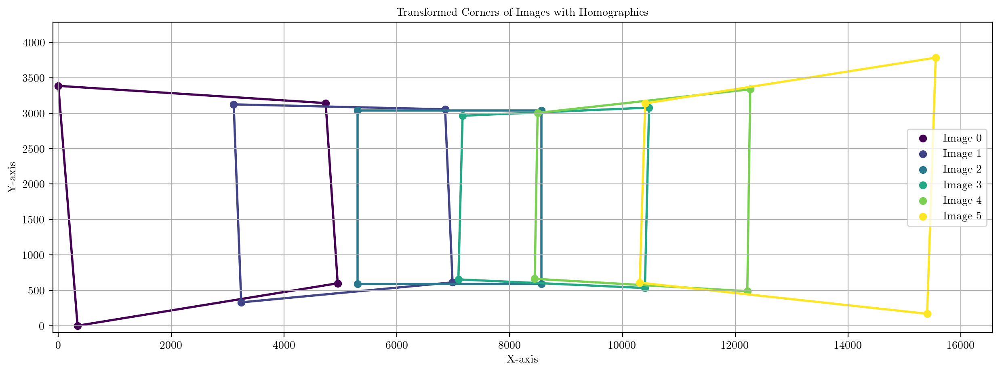

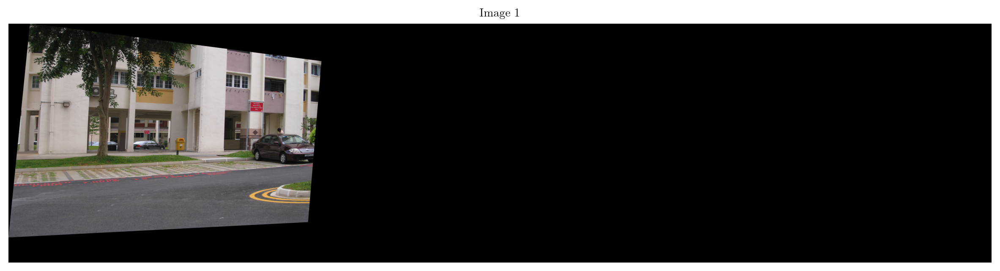

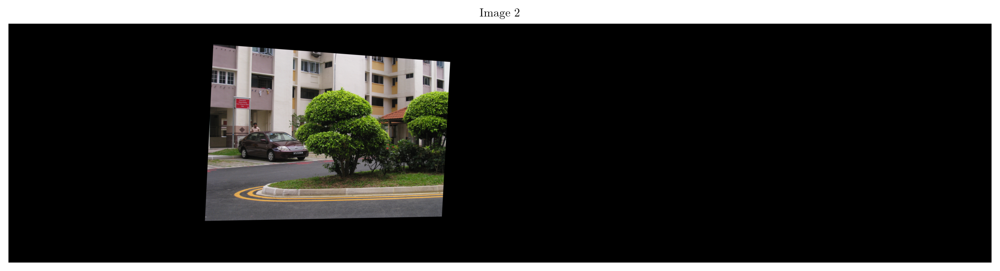

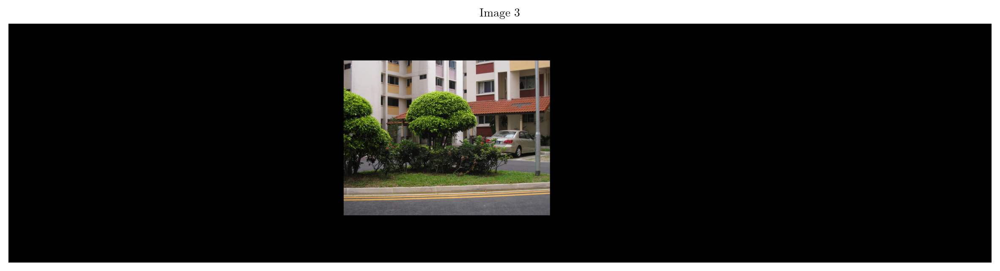

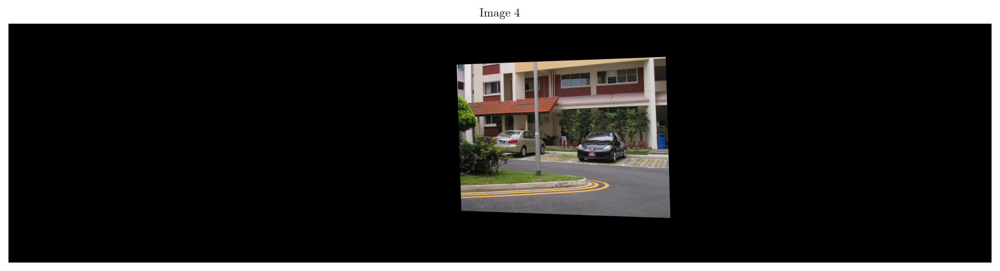

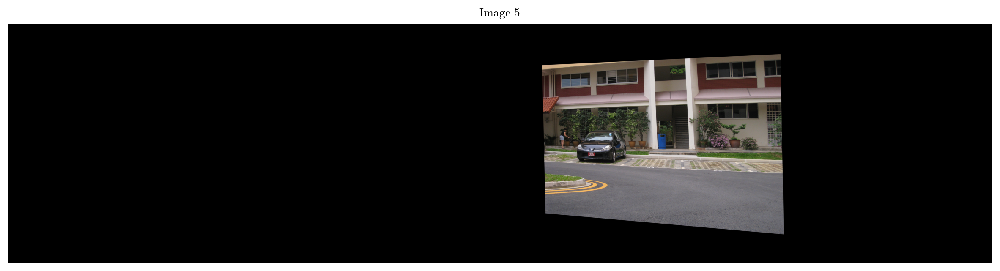

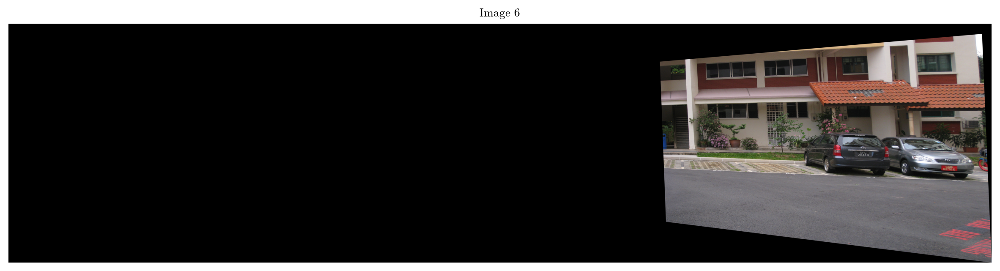

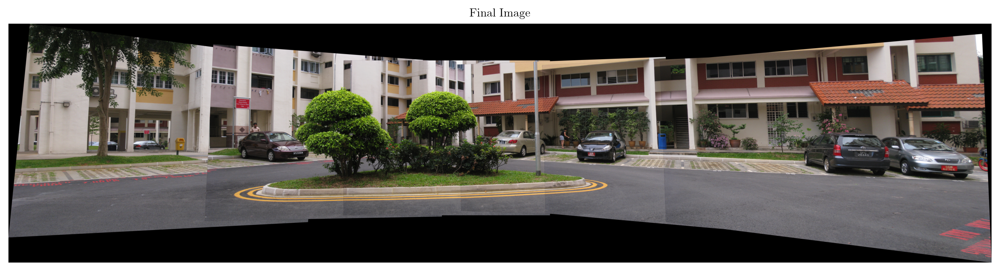

In [20]:
warped_images = panorama_stitcher(images_i1, useOpenCV = False, first_over_last = False)

# Distance Transform

In [56]:
def single_weights_array(size: int) -> np.ndarray:
    """
    Create a 1D weights array.

    Args:
        size: Size of the array

    Returns:
        weights: 1D weights array
    """
    if size % 2 == 1:
        return np.concatenate(
            [np.linspace(0, 1, (size + 1) // 2), np.linspace(1, 0, (size + 1) // 2)[1:]]
        )
    else:
        return np.concatenate([np.linspace(0, 1, size // 2), np.linspace(1, 0, size // 2)])


def single_weights_matrix(shape: tuple[int]) -> np.ndarray:
    """
    Create a 2D weights matrix.

    Args:
        shape: Shape of the matrix

    Returns:
        weights: 2D weights matrix
    """
    return (
        single_weights_array(shape[0])[:, np.newaxis]
        @ single_weights_array(shape[1])[:, np.newaxis].T
    )

# Rightward (Left to Right)

## IMAGE1 and IMAGE2

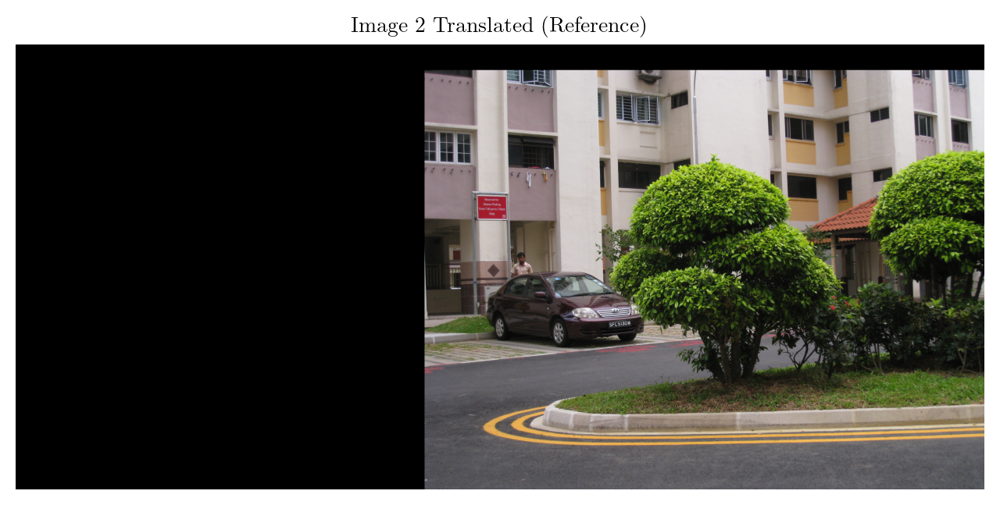

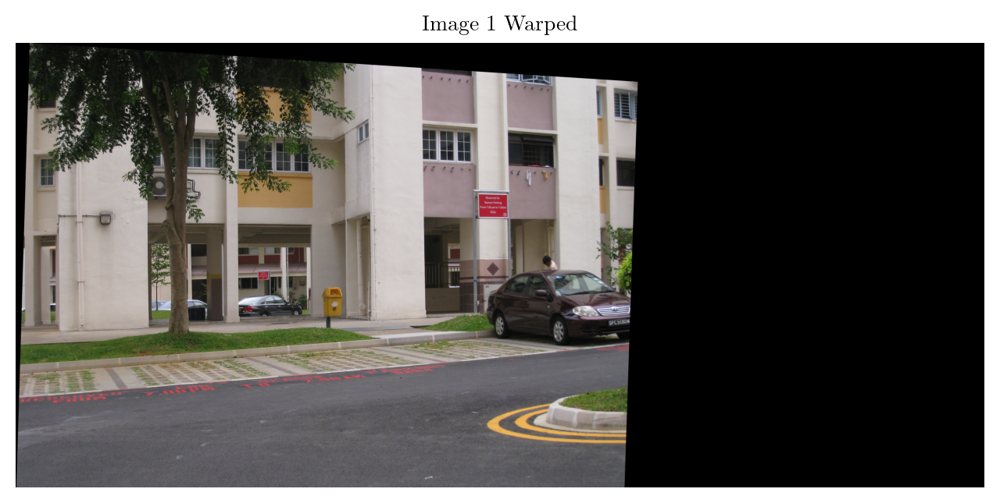

In [57]:
H = estimate_homography(images_i1[0], images_i1[1], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(images_i1[0], H)

shift_matrix12 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])

final_canvas_width = images_i1[1].shape[1] - int(min_x)
final_canvas_height = images_i1[1].shape[0] - int(min_y)

image2_warped = cv2.warpPerspective(images_i1[1], shift_matrix12, (final_canvas_width, final_canvas_height))
image1_warped = cv2.warpPerspective(images_i1[0], shift_matrix12 @ H, (final_canvas_width, final_canvas_height))

plt.figure(figsize=(8, 8))
plt.title("Image 2 Translated (Reference)")
plt.imshow(cv2.cvtColor(image2_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 1 Warped")
plt.imshow(cv2.cvtColor(image1_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

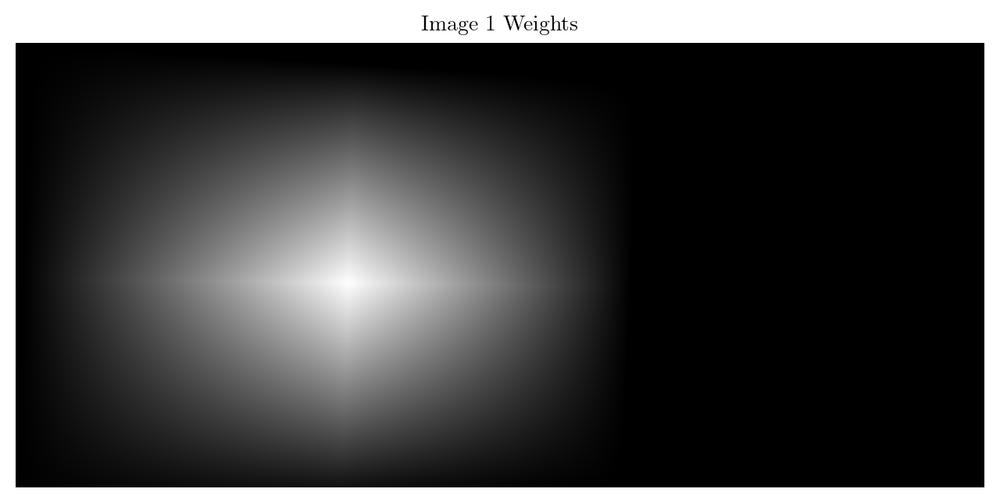

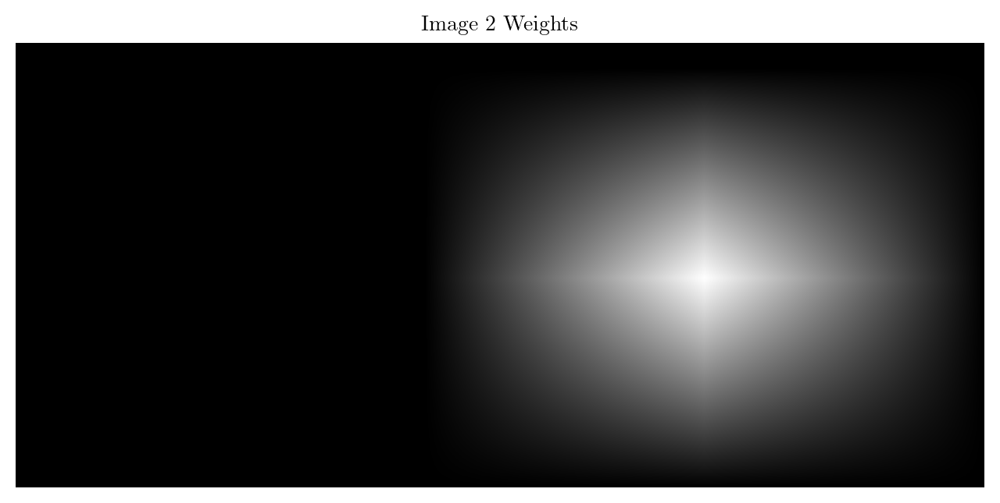

In [58]:
image1, image2 = images_i1[0], images_i1[1]

weight1 = single_weights_matrix(image1.shape[:2])
weight2 = single_weights_matrix(image2.shape[:2])

warped_weight1 = cv2.warpPerspective(weight1, shift_matrix12 @ H, (final_canvas_width, final_canvas_height))
warped_weight2 = cv2.warpPerspective(weight2, shift_matrix12, (final_canvas_width, final_canvas_height))

weight1 = np.repeat(warped_weight1[:, :, np.newaxis], 3, axis=2)
weight2 = np.repeat(warped_weight2[:, :, np.newaxis], 3, axis=2)

plt.figure(figsize=(8, 8))
plt.title("Image 1 Weights")
plt.imshow(weight1, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 2 Weights")
plt.imshow(weight2, cmap='gray')
plt.axis('off')
plt.show()

## BLENDED IMAGE12

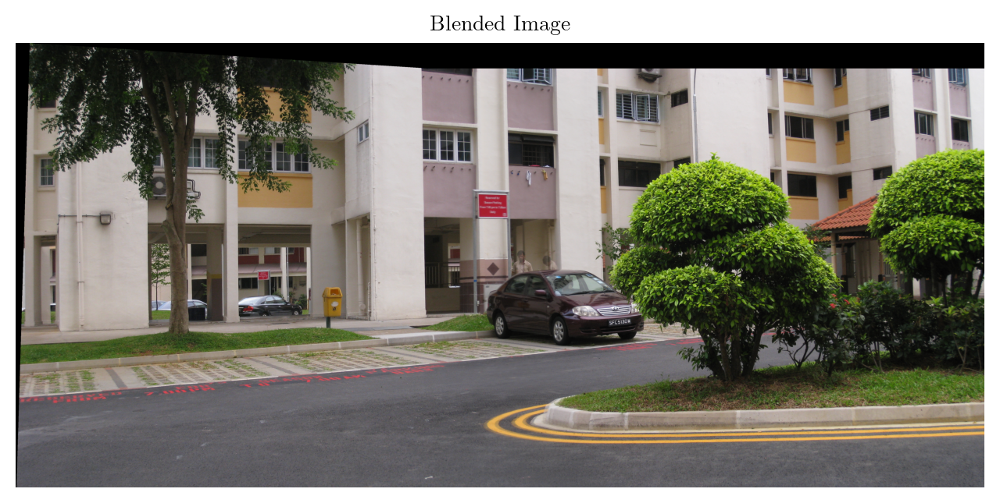

In [59]:
total_weight12 = (weight1 + weight2) / (weight1 + weight2).max()
weight1_normalized = np.divide(weight1, total_weight12, where=total_weight12 != 0)
weight2_normalized = np.divide(weight2, total_weight12, where=total_weight12 != 0)

blended_image = (image1_warped * weight1_normalized + image2_warped * weight2_normalized).astype(np.uint8)

plt.figure(figsize=(8, 8))
plt.title("Blended Image")
plt.imshow(cv2.cvtColor(blended_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

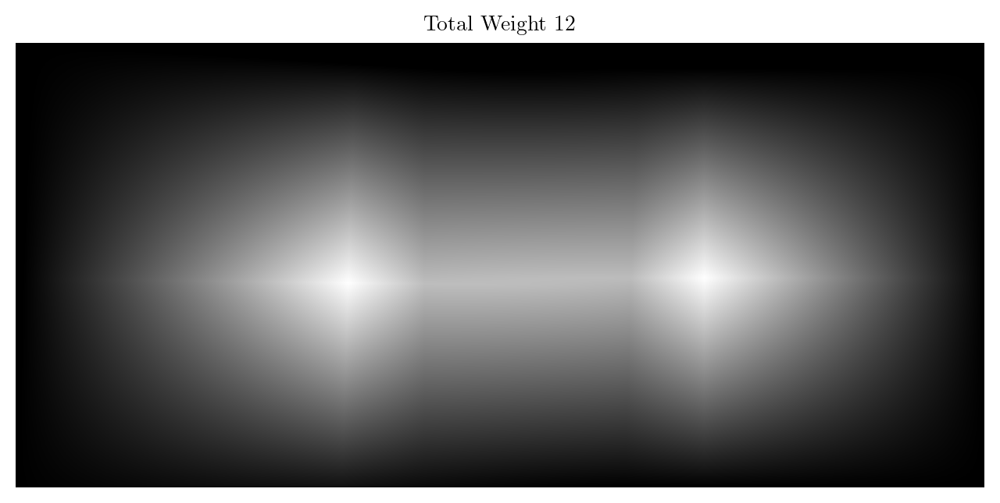

In [60]:
plt.figure(figsize=(8, 8))
plt.title("Total Weight 12")
plt.imshow(total_weight12, cmap='gray')
plt.axis('off')
plt.show()

## IMAGE12 and IMAGE3

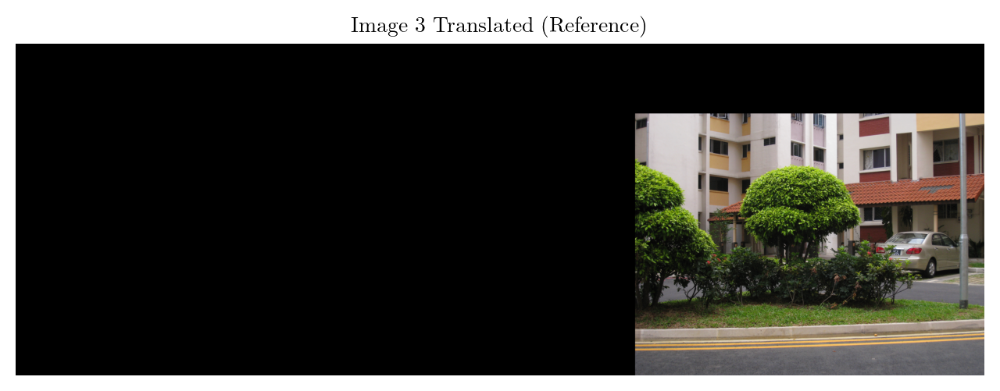

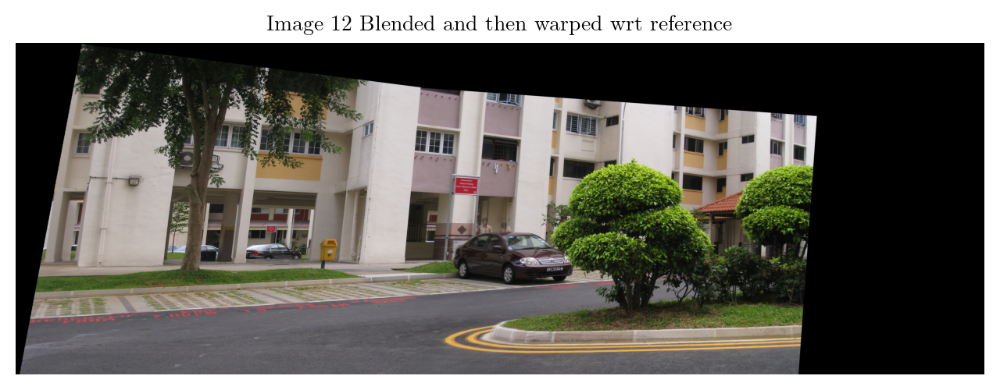

In [61]:
image3 = images_i1[2]
H = estimate_homography(images_i1[1], images_i1[2], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(blended_image, H @ np.linalg.inv(shift_matrix12))

shift_matrix12_3 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])

final_canvas_width = image3.shape[1] - int(min_x)
final_canvas_height = image3.shape[0] - int(min_y)

image3_warped = cv2.warpPerspective(image3, shift_matrix12_3, (final_canvas_width, final_canvas_height))
blended_image_warped = cv2.warpPerspective(blended_image, shift_matrix12_3 @ H @ np.linalg.inv(shift_matrix12), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(8, 8))
plt.title("Image 3 Translated (Reference)")
plt.imshow(cv2.cvtColor(image3_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 12 Blended and then warped wrt reference")
plt.imshow(cv2.cvtColor(blended_image_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [62]:
corners

array([[-5296.6724 ,  -651.62695],
       [-5787.9834 ,  2603.189  ],
       [ 1521.8457 ,  2499.9573 ],
       [ 1707.7015 ,  -114.06125]], dtype=float32)

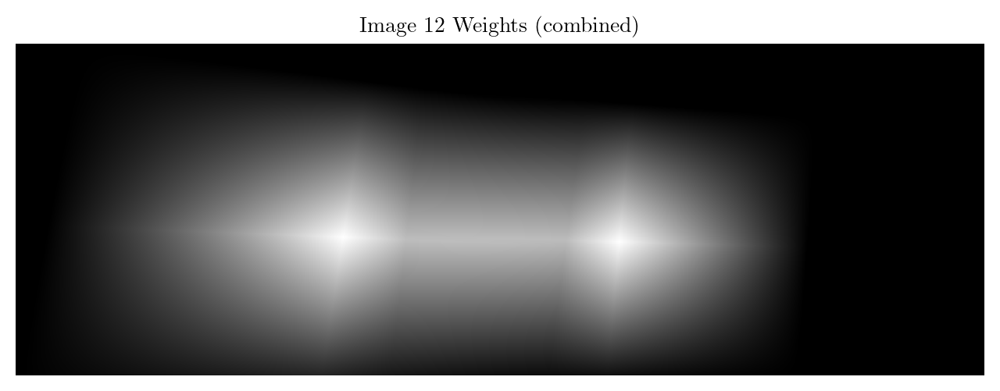

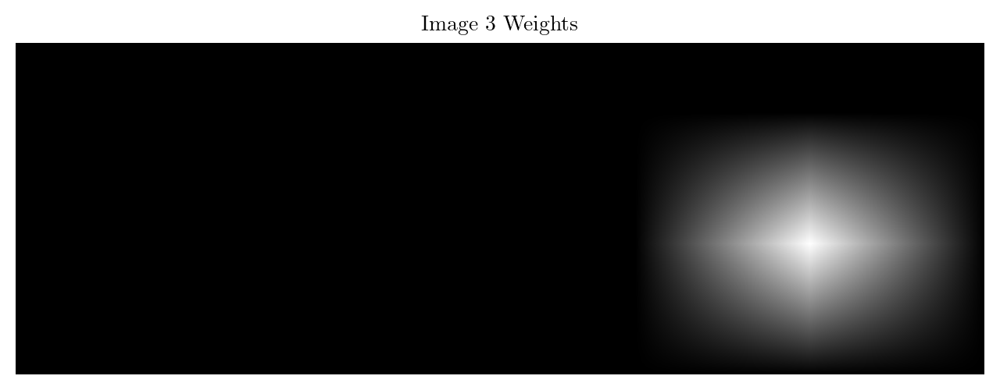

In [63]:
image3 = images_i1[1]

weight3 = single_weights_matrix(image3.shape[:2])

warped_weight3 = cv2.warpPerspective(weight3, shift_matrix12_3, (final_canvas_width, final_canvas_height))
total_weight12 = cv2.warpPerspective(total_weight12, shift_matrix12_3 @ H @ np.linalg.inv(shift_matrix12), (final_canvas_width, final_canvas_height))

weight3 = np.repeat(warped_weight3[:, :, np.newaxis], 3, axis=2)

plt.figure(figsize=(8, 8))
plt.title("Image 12 Weights (combined)")
plt.imshow(total_weight12, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 3 Weights")
plt.imshow(weight3, cmap='gray')
plt.axis('off')
plt.show()

## BLENDED IMAGE123

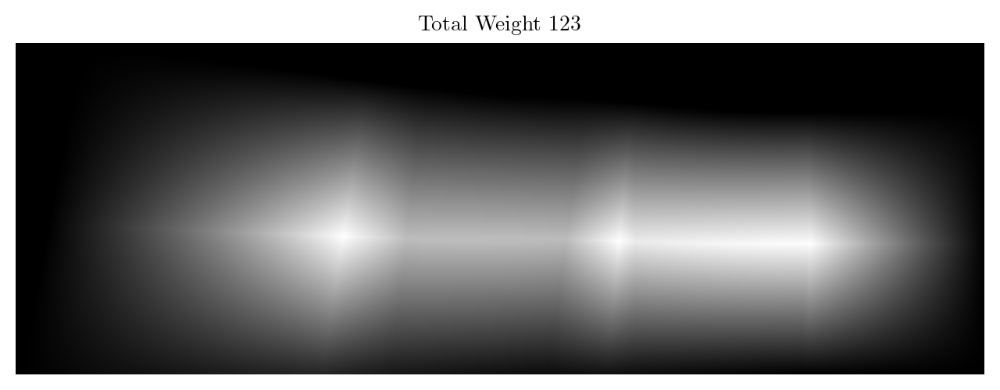

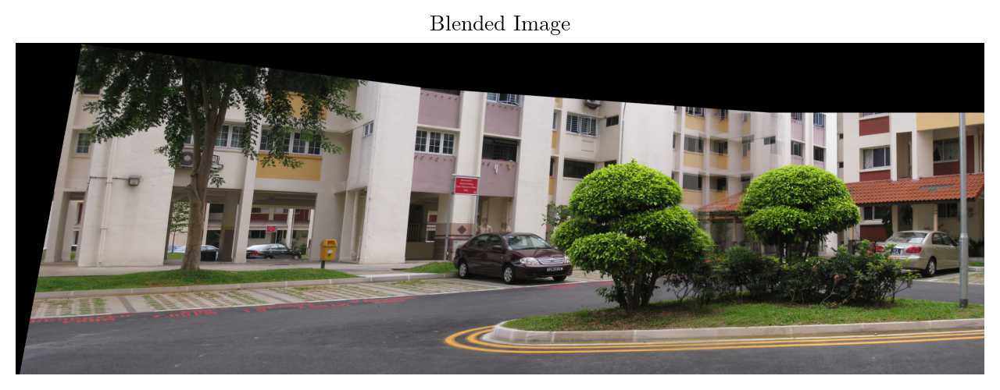

In [64]:
total_weight12_3 = (total_weight12 + weight3)/ (total_weight12 + weight3).max()

weight12_normalized = np.divide(total_weight12, total_weight12_3, where=total_weight12_3 != 0)
weight3_normalized = np.divide(weight3, total_weight12_3, where=total_weight12_3 != 0)

blended_image12_3 = (blended_image_warped * weight12_normalized + image3_warped * weight3_normalized).astype(np.uint8)

plt.figure(figsize=(8, 8))
plt.title("Total Weight 123")
plt.imshow(total_weight12_3, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Blended Image")
plt.imshow(cv2.cvtColor(blended_image12_3, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [65]:
W_final_canvas_width, H_final_canvas_height = final_canvas_width, final_canvas_height 

# BackWard (Right to Left)

## IMAGE6 and IMAGE5

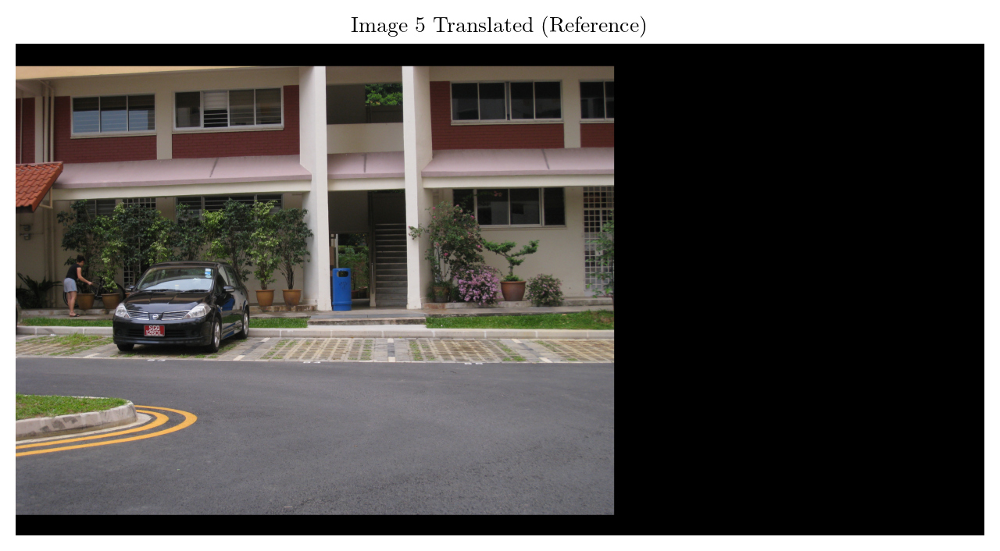

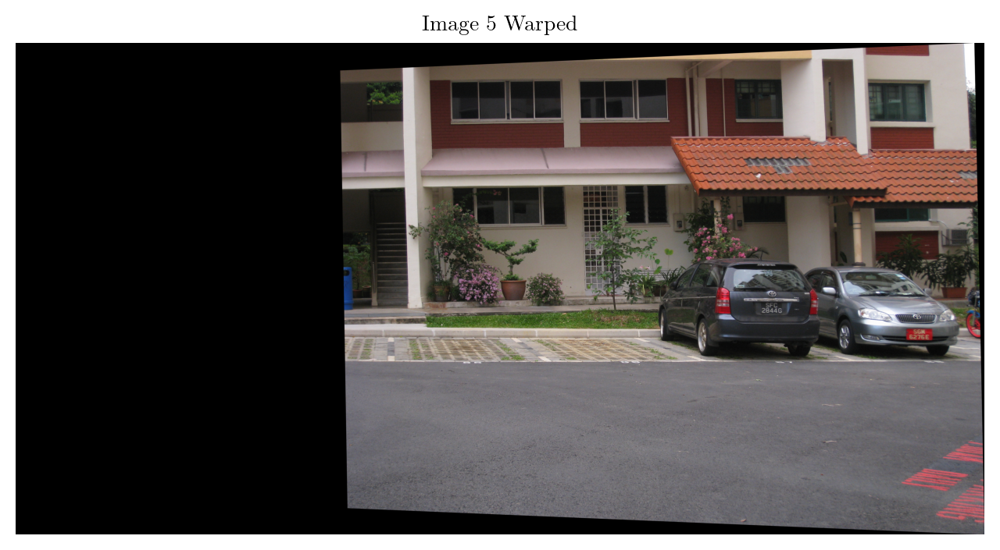

In [66]:
H = estimate_homography(images_i1[5], images_i1[4], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(images_i1[5], H)

shift_x = -min(min_x, 0)
shift_y = -min(min_y, 0)

shift_matrix65 = np.array([[1, 0, shift_x], [0, 1, shift_y], [0, 0, 1]])

final_canvas_width = int(max(max_x, images_i1[4].shape[1]) + shift_x)
final_canvas_height = int(max(max_y, images_i1[4].shape[0]) + shift_y)

image5_warped = cv2.warpPerspective(images_i1[4], shift_matrix65, (final_canvas_width, final_canvas_height))
image6_warped = cv2.warpPerspective(images_i1[5], shift_matrix65 @ H, (final_canvas_width, final_canvas_height))

plt.figure(figsize=(8, 8))
plt.title("Image 5 Translated (Reference)")
plt.imshow(cv2.cvtColor(image5_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 5 Warped")
plt.imshow(cv2.cvtColor(image6_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [67]:
corners

array([[1769.9764 ,   28.12275],
       [1809.8016 , 2415.3813 ],
       [5283.244  , 2560.2073 ],
       [5227.383  , -122.41488]], dtype=float32)

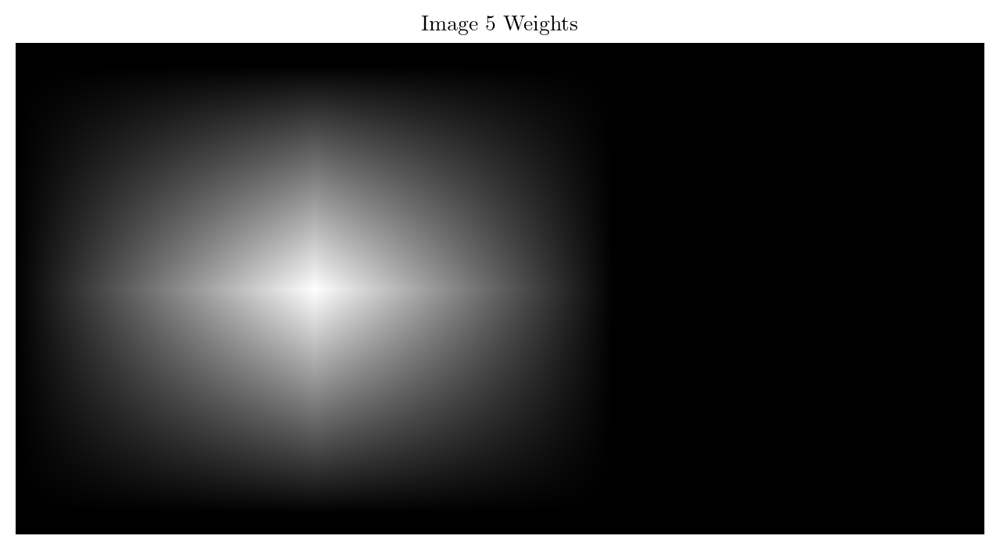

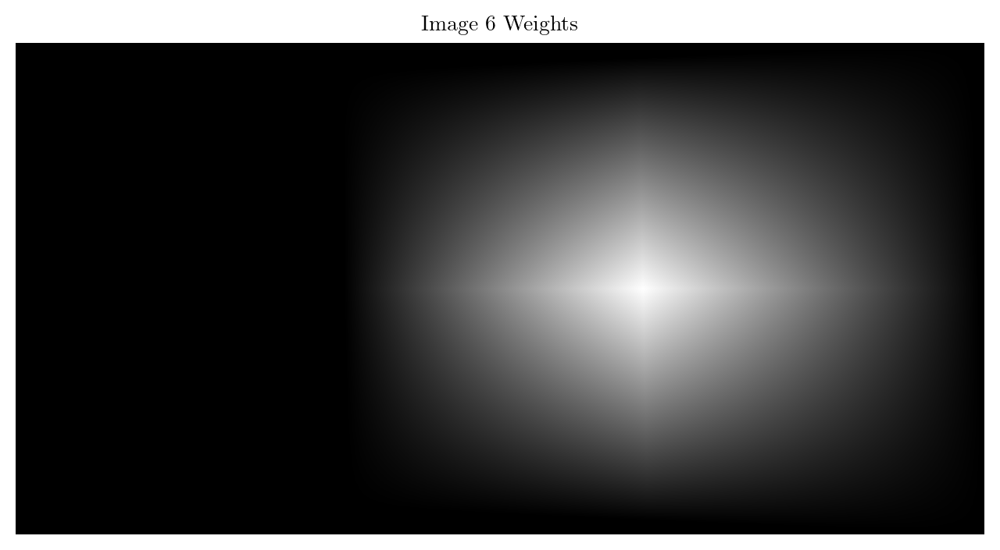

In [68]:
image5, image6 = images_i1[4], images_i1[5]

weight5 = single_weights_matrix(image5.shape[:2])
weight6 = single_weights_matrix(image6.shape[:2])

warped_weight5 = cv2.warpPerspective(weight5, shift_matrix65, (final_canvas_width, final_canvas_height))
warped_weight6 = cv2.warpPerspective(weight6, shift_matrix65 @ H, (final_canvas_width, final_canvas_height))

weight5 = np.repeat(warped_weight5[:, :, np.newaxis], 3, axis=2)
weight6 = np.repeat(warped_weight6[:, :, np.newaxis], 3, axis=2)


plt.figure(figsize=(8, 8))
plt.title("Image 5 Weights")
plt.imshow(weight5, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 6 Weights")
plt.imshow(weight6, cmap='gray')
plt.axis('off')
plt.show()

## BLENDED IMAGE65

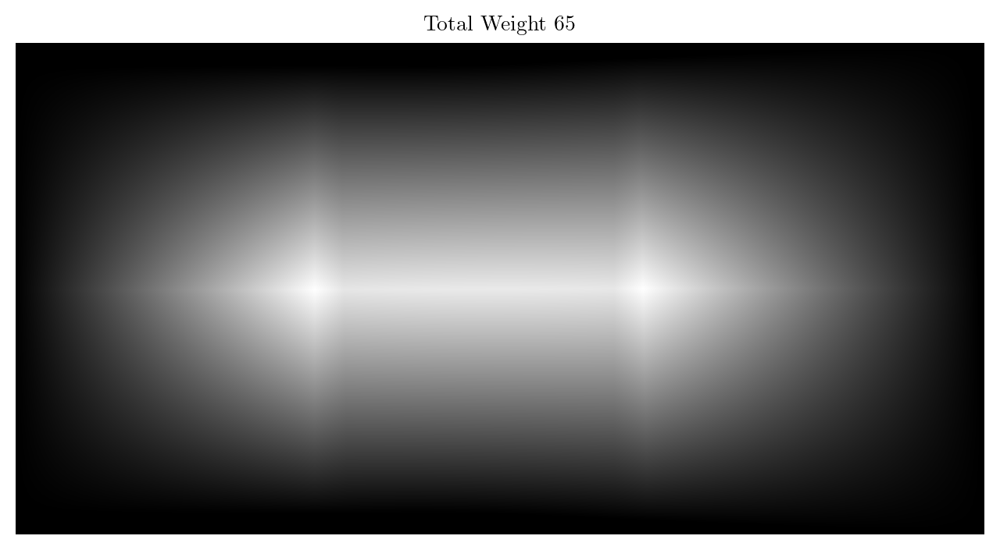

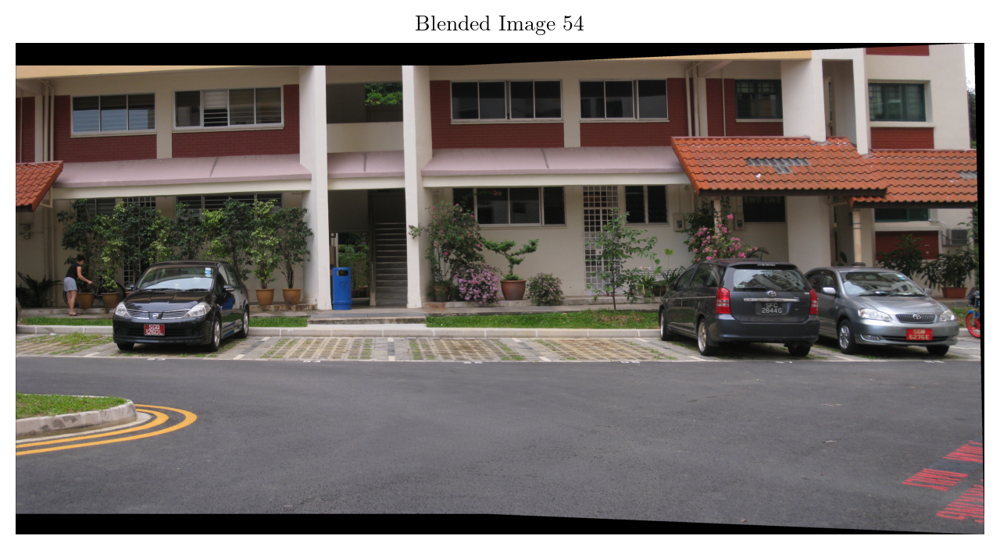

In [69]:
total_weight65 = (weight5 + weight6) / (weight5 + weight6).max()
weight5_normalized = np.divide(weight5, total_weight65, where=total_weight65 != 0)
weight6_normalized = np.divide(weight6, total_weight65, where=total_weight65 != 0)

blended_image65 = (image5_warped * weight5_normalized + image6_warped * weight6_normalized).astype(np.uint8)

plt.figure(figsize=(8, 8))
plt.title("Total Weight 65")
plt.imshow(total_weight65, cmap = "gray")
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Blended Image 54")
plt.imshow(cv2.cvtColor(blended_image65, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

## IMAGE65 and IMAGE4

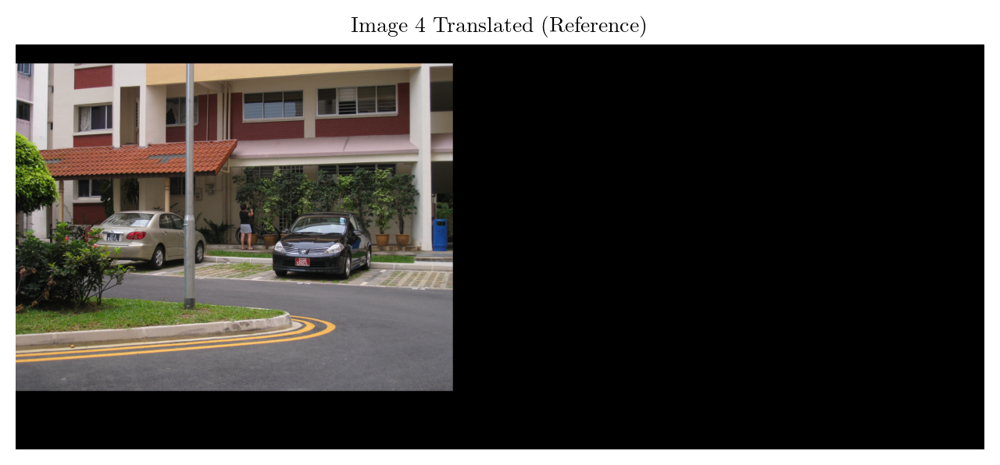

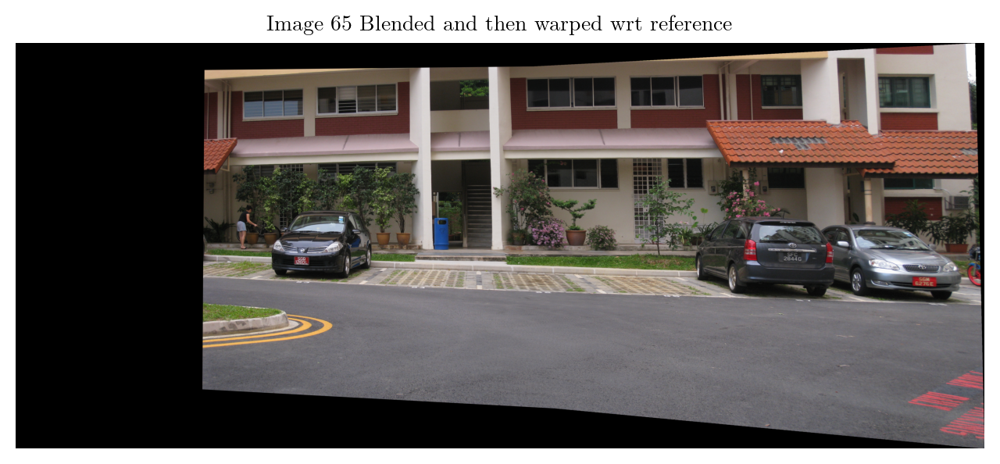

In [70]:
H = estimate_homography(images_i1[4], images_i1[3], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(blended_image65, H @ np.linalg.inv(shift_matrix65))

shift_x = -min(min_x, 0)
shift_y = -min(min_y, 0)

shift_matrix65_4 = np.array([[1, 0, shift_x], [0, 1, shift_y], [0, 0, 1]])

final_canvas_width = int(max(max_x, images_i1[3].shape[1]) + shift_x)
final_canvas_height = int(max(max_y, images_i1[3].shape[0]) + shift_y)

image4_warped = cv2.warpPerspective(images_i1[3], shift_matrix65_4, (final_canvas_width, final_canvas_height))
blended_image65_warped = cv2.warpPerspective(blended_image65, shift_matrix65_4 @ H @ np.linalg.inv(shift_matrix65), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(8, 8))
plt.title("Image 4 Translated (Reference)")
plt.imshow(cv2.cvtColor(image4_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 65 Blended and then warped wrt reference")
plt.imshow(cv2.cvtColor(blended_image65_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [71]:
corners

array([[1409.4568  ,  -59.187107],
       [1392.0715  , 2552.2747  ],
       [7231.38    , 2885.2957  ],
       [7231.375   , -141.53815 ]], dtype=float32)

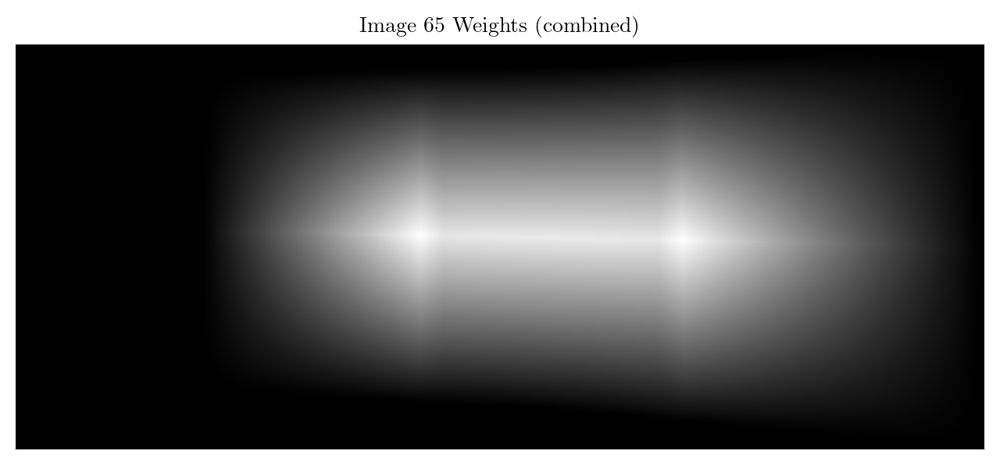

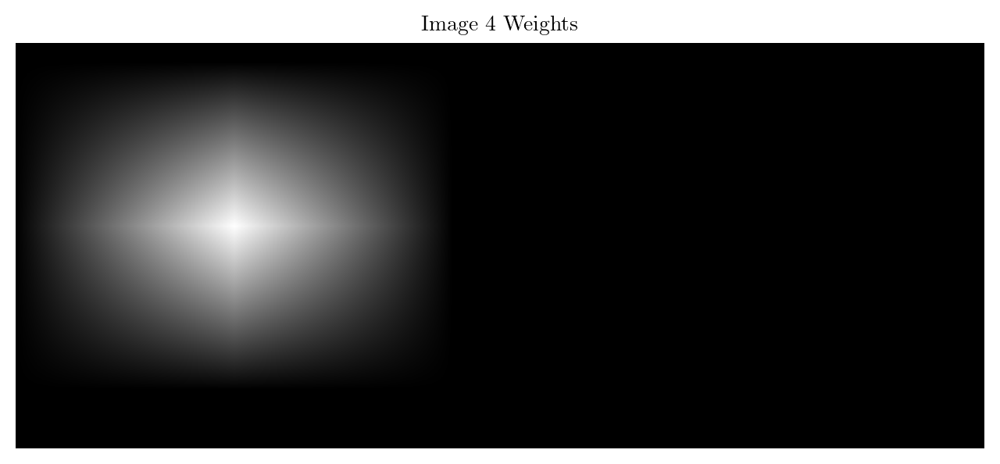

In [72]:
image4 = images_i1[3]

weight4 = single_weights_matrix(image4.shape[:2])

warped_weight4 = cv2.warpPerspective(weight4, shift_matrix65_4, (final_canvas_width, final_canvas_height))

total_weight65 = cv2.warpPerspective(total_weight65, shift_matrix65_4 @ H @ np.linalg.inv(shift_matrix65), (final_canvas_width, final_canvas_height))

weight4 = np.repeat(warped_weight4[:, :, np.newaxis], 3, axis=2)

plt.figure(figsize=(8, 8))
plt.title("Image 65 Weights (combined)")
plt.imshow(total_weight65, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Image 4 Weights")
plt.imshow(weight4, cmap='gray')
plt.axis('off')
plt.show()

## BLENDED IMAGE654

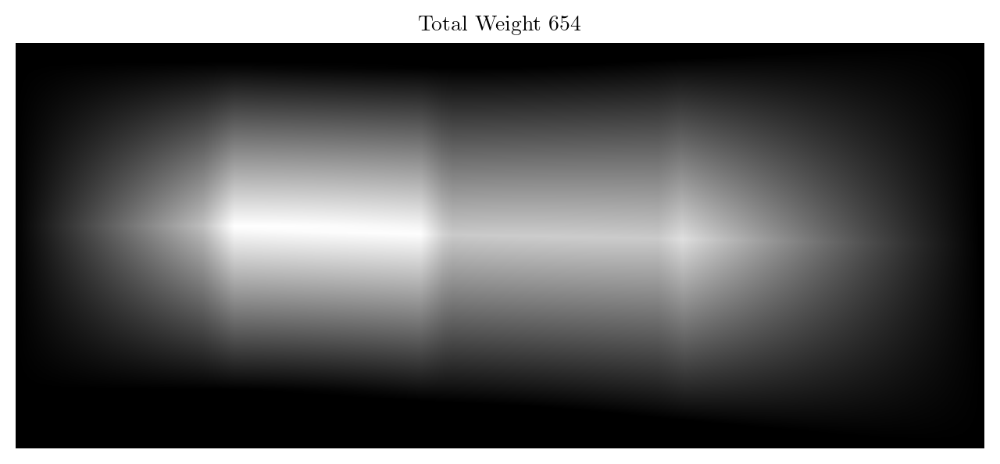

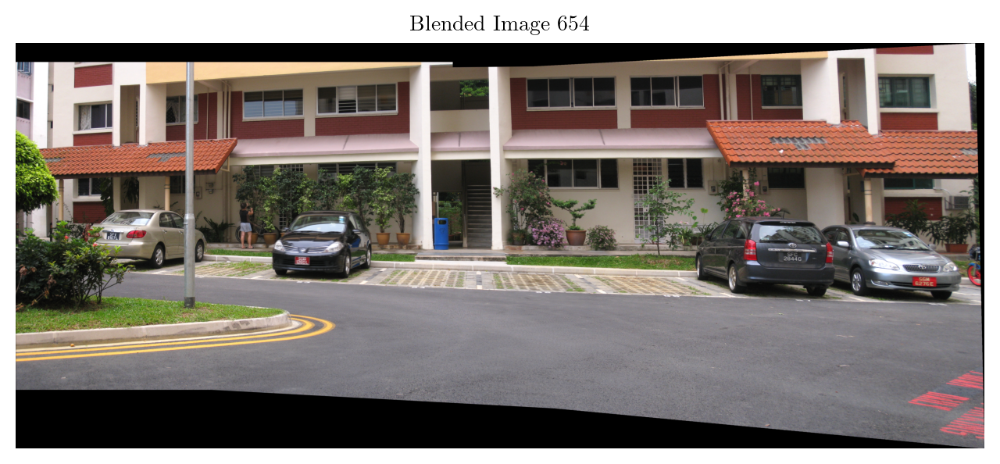

In [73]:
total_weight65_4 = (total_weight65 + weight4)/ (total_weight65 + weight4).max()

weight65_normalized = np.divide(total_weight65, total_weight65_4, where=total_weight65_4 != 0)
weight4_normalized = np.divide(weight4, total_weight65_4, where=total_weight65_4 != 0)

blended_image65_4 = np.clip((blended_image65_warped * weight65_normalized + image4_warped * weight4_normalized), 0, 255).astype(np.uint8)

plt.figure(figsize=(8, 8))
plt.title("Total Weight 654")
plt.imshow(total_weight65_4, cmap = "gray")
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Blended Image 654")
plt.imshow(cv2.cvtColor(blended_image65_4, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Finally to Blend IMAGE123 and IMAGE654

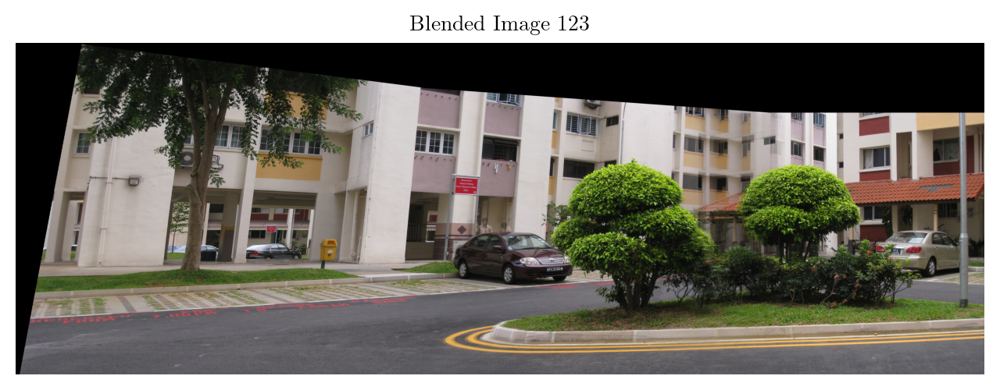

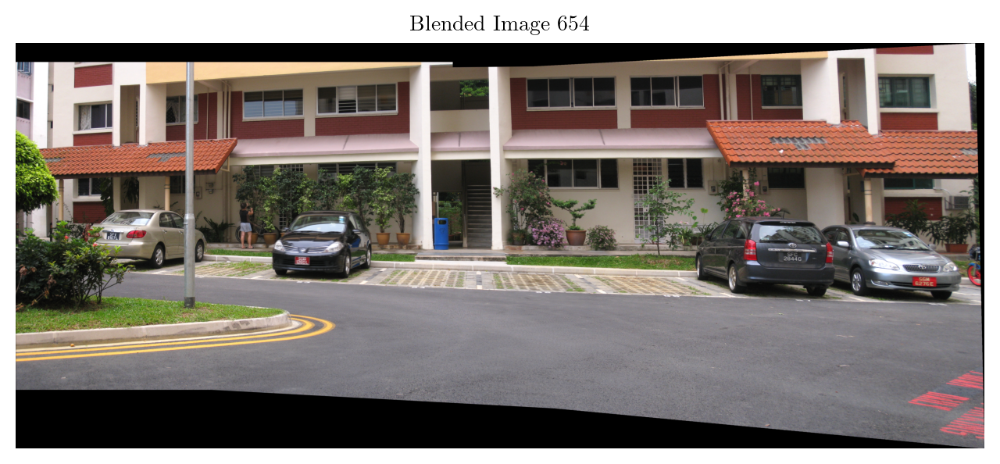

In [74]:
plt.figure(figsize=(8, 8))
plt.title("Blended Image 123")
plt.imshow(cv2.cvtColor(blended_image12_3, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(8, 8))
plt.title("Blended Image 654")
plt.imshow(cv2.cvtColor(blended_image65_4, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [75]:
blended_image12_3.shape, blended_image65_4.shape

((3099, 9051, 3), (3026, 7231, 3))

In [76]:
H = estimate_homography(images_i1[3], images_i1[2], useOpenCV=False)

corners, min_x, min_y, max_x, max_y = transform_corners(blended_image65_4, H @ np.linalg.inv(shift_matrix65_4))
print(corners)

corners1, min_x1, min_y1, max_x1, max_y1 = transform_corners(blended_image12_3, np.linalg.inv(shift_matrix12_3))
print(corners1)

final_canvas_width = int(max_x - min_x1)
final_canvas_height = int(max(max_y, max_y1) - min(min_y, min_y1))

print(final_canvas_width, final_canvas_height)

[[ 1784.8947    -70.99433]
 [ 1873.2496   2782.4575 ]
 [10625.671    3239.3064 ]
 [10617.636    -539.8479 ]]
[[-5787.9834   -651.62695]
 [-5787.9834   2446.373  ]
 [ 3262.0166   2446.373  ]
 [ 3262.0166   -651.62695]]
16413 3890


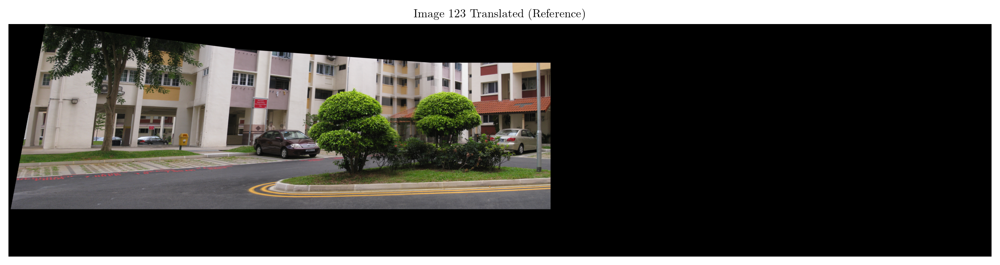

In [77]:
shift_matrix123_654 = np.array([[1, 0, -min_x1], [0, 1, -min(min_y1, min_y)], [0, 0, 1]])
image123_warped = cv2.warpPerspective(blended_image12_3, shift_matrix123_654 @ np.linalg.inv(shift_matrix12_3), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(15, 15))
plt.title("Image 123 Translated (Reference)")
plt.imshow(cv2.cvtColor(image123_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

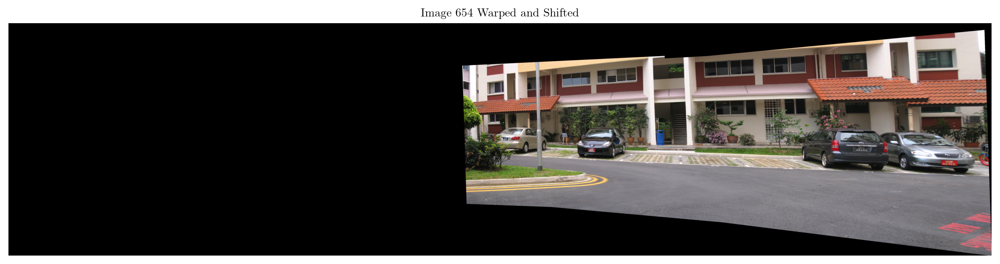

In [78]:
shift_matrix654_123 = np.array([[1, 0, (final_canvas_width - max_x)], [0, 1, -min(min_y1, min_y)], [0, 0, 1]])
image654_warped = cv2.warpPerspective(blended_image65_4, shift_matrix654_123 @ H @ np.linalg.inv(shift_matrix65_4), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(15, 15))
plt.title("Image 654 Warped and Shifted")
plt.imshow(cv2.cvtColor(image654_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

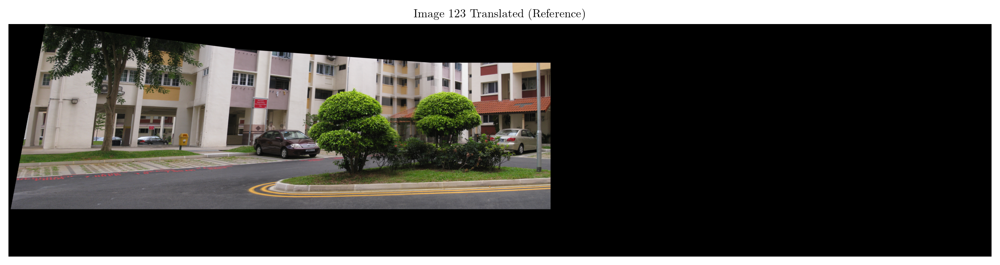

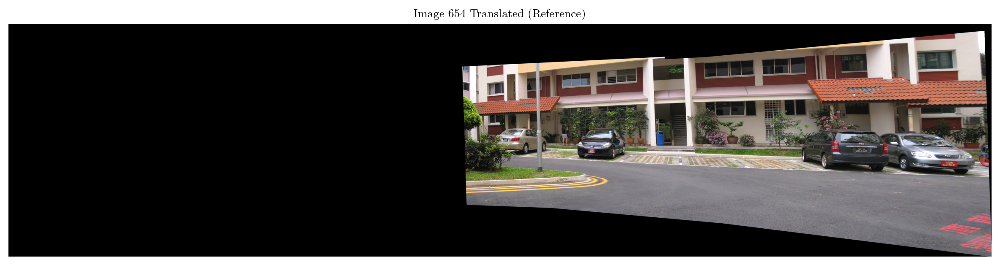

In [79]:
plt.figure(figsize=(15, 15))
plt.title("Image 123 Translated (Reference)")
plt.imshow(cv2.cvtColor(image123_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(15, 15))
plt.title("Image 654 Translated (Reference)")
plt.imshow(cv2.cvtColor(image654_warped, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

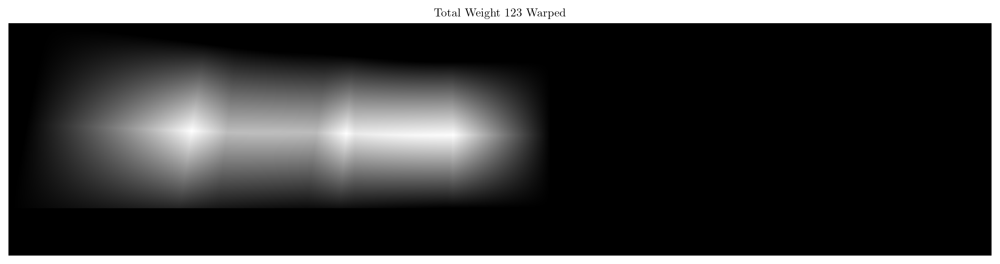

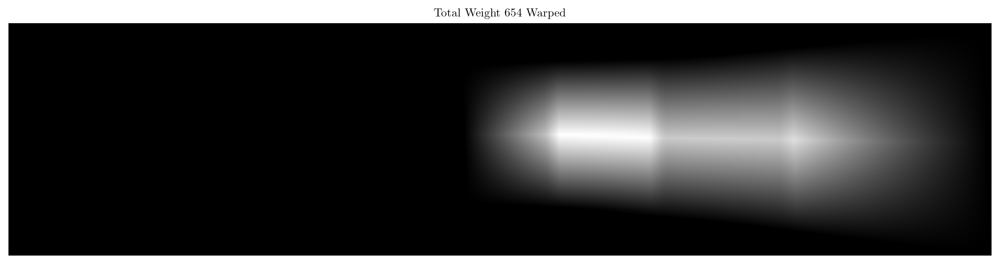

In [80]:
total_weight12_3_warped = cv2.warpPerspective(total_weight12_3, shift_matrix123_654 @ np.linalg.inv(shift_matrix12_3), (final_canvas_width, final_canvas_height))
total_weight654_warped = cv2.warpPerspective(total_weight65_4, shift_matrix654_123 @ H @ np.linalg.inv(shift_matrix65_4), (final_canvas_width, final_canvas_height))

plt.figure(figsize=(15, 15))
plt.title("Total Weight 123 Warped")
plt.imshow(total_weight12_3_warped, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(15, 15))
plt.title("Total Weight 654 Warped")
plt.imshow(total_weight654_warped, cmap='gray')
plt.axis('off')
plt.show()

In [81]:
total_weight123_654 = (total_weight12_3_warped + total_weight654_warped) / (total_weight12_3_warped + total_weight654_warped).max()

weight123_normalized = np.divide(total_weight12_3_warped, total_weight123_654, where=total_weight123_654 != 0)
weight654_normalized = np.divide(total_weight654_warped, total_weight123_654, where=total_weight123_654 != 0)

blended_image123_654 = np.clip((image123_warped * weight123_normalized + image654_warped * weight654_normalized), 0, 255).astype(np.uint8)

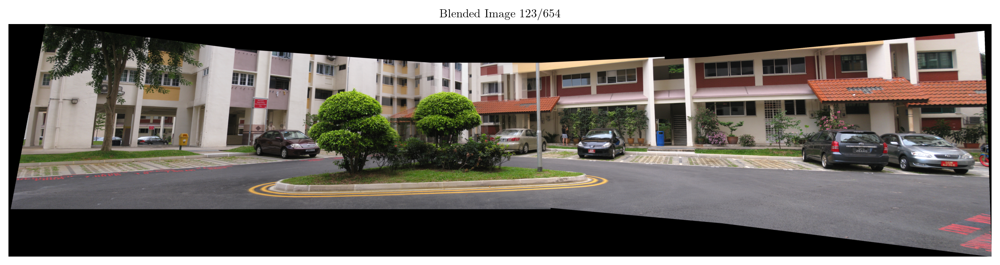

In [82]:
plt.figure(figsize=(15, 15))
plt.title("Blended Image 123/654")
plt.imshow(cv2.cvtColor(blended_image123_654, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()